# cleanup tide gauge data
    

In [1]:
import os
from glob import glob

%matplotlib inline
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import xarray as xr
import hvplot.pandas  # noqa
import hvplot.xarray  # noqa

import scipy.io as sio

import pynsitu as pin

/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/pyTMD/tools.py:55: UserWarning: ipyleaflet not available
  warnings.warn("ipyleaflet not available")
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/pyTMD/tools.py:56: UserWarning: Some functions will throw an exception if called
  warnings.warn("Some functions will throw an exception if called")


In [2]:
## taos
root_dir = "/Users/aponte/Current_Projects/taos/campagnes/other/"

campaign="taos_other"
yaml = campaign+".yaml"

cp = pin.Campaign(os.path.join(root_dir,yaml))

# plot all deployments
for label, deployment, platform, sensor, meta in cp.get_all_deployments():
    print(label, platform, sensor, deployment)

d0 smile adcp d0 / start 2019-07-12 00:00:00 / end 2019-11-08 23:30:00
d1 smile adcp d1 / start 2020-02-06 00:00:00 / end 2020-05-05 05:30:00
d2 smile adcp d2 / start 2020-07-09 12:30:00 / end 2020-11-24 12:00:00
d3 smile adcp d3 / start 2021-05-20 10:15:00 / end 2021-11-16 14:15:00
d4 smile adcp d4 / start 2021-12-14 12:15:00 / end 2022-05-06 11:45:00
do0 smile hydro do0 / start 2015-06-05 10:51:21 / end 2015-11-27 09:08:10
do1 smile hydro do1 / start 2016-06-16 09:05:07 / end 2017-06-09 04:30:00
hy0 smile hydro hy0 / start 2015-07-21 12:25:21 / end 2015-11-27 08:48:09
hy1 smile hydro hy1 / start 2015-12-17 04:16:34 / end 2016-02-08 19:56:36
hy2 smile hydro hy2 / start 2016-05-12 14:08:39 / end 2016-08-17 09:23:54
hy3 smile hydro hy3 / start 2016-08-17 10:09:54 / end 2016-09-05 05:15:17
hy4 smile hydro hy4 / start 2016-09-20 11:57:31 / end 2017-06-09 05:08:05


### select constituents

This needs to be reworked

In [3]:
# option 0
#cst = ["O1", "K1", "M2", "S2"]
#cst = cst + ["M4", "MS4"]

# option 1
c = pin.tseries.load_equilibrium_constituents()
cst = [c.upper() for c in list(c.sort_values("amplitude", ascending=False)
                               .iloc[:].index
                              )
      ]
print(cst)

# option 2
import pytide
wt = pytide.WaveTable()
cst = wt.constituents()
cst = [c.upper() for c in cst]
print(cst)

# filter out some consistuents
cst = [c for c in cst if c not in ["MF", "MM", "SSA", "NU2", "MU2", "EPS2", "MSF", "LAMBDA2", "MSQM", "SA", "MTM"]]
cst = [c for c in cst if c not in ["ETA2", "SIGMA1", "RHO1", "CHI1", "PI1", "PHI1", "THETA1", "PSI1"]]
print(cst)

['M2', 'K1', 'S2', 'O1', 'P1', 'N2', 'MF', 'K2', 'MM', 'SSA', 'Q1', 'NU2', 'J1', 'MU2', 'L2', 'T2', '2N2', 'MN4', 'M4', 'MS4', 'M6', 'M3', 'EPS2', 'R2', 'S1', 'S4', 'MKS2', 'MSF', 'LAMBDA2', 'MSQM', 'SA', 'MTM', 'N4', 'M8']
['O1', 'P1', 'K1', '2N2', 'MU2', 'N2', 'NU2', 'M2', 'L2', 'T2', 'S2', 'K2', 'M4', 'S1', 'Q1', 'MM', 'MF', 'MTM', 'MSQM', 'EPS2', 'LAMBDA2', 'ETA2', '2Q1', 'SIGMA1', 'RHO1', 'M11', 'M12', 'CHI1', 'PI1', 'PHI1', 'THETA1', 'J1', 'OO1', 'M3', 'M6', 'MN4', 'MS4', 'N4', 'R2', 'R4', 'S4', 'MNS2', 'M13', 'MK4', 'SN4', 'SK4', '2MN6', '2MS6', '2MK6', 'MSN6', '2SM6', 'MSK6', 'MP1', '2SM2', 'PSI1', '2MS2', 'MKS2', '2MN2', 'MSN2', 'MO3', '2MK3', 'MK3', 'S6', 'M8', 'MSF', 'SSA', 'SA']
['O1', 'P1', 'K1', '2N2', 'N2', 'M2', 'L2', 'T2', 'S2', 'K2', 'M4', 'S1', 'Q1', '2Q1', 'M11', 'M12', 'J1', 'OO1', 'M3', 'M6', 'MN4', 'MS4', 'N4', 'R2', 'R4', 'S4', 'MNS2', 'M13', 'MK4', 'SN4', 'SK4', '2MN6', '2MS6', '2MK6', 'MSN6', '2SM6', 'MSK6', 'MP1', '2SM2', '2MS2', 'MKS2', '2MN2', 'MSN2', 'MO3'

---

## tide gauge


Ouistreham tide gauge


In [73]:
p = "tide_gauge_ouistreham"

tgauge_files = sorted(glob(os.path.join(cp["path_raw"], cp[p]["files"])))

ds = xr.open_dataset(tgauge_files[-1])
#ds = xr.open_mfdataset(tgauge_files[-2:])

ds = ds.rename(dict(TIME="time", 
                    LATITUDE="latitude", LONGITUDE="longitude",
                    Source1="sea_level",
                   )
              )

# minor manual editing
ds["sea_level"] = ds["sea_level"].where(ds["sea_level"]<10)

# demean sea level
ds["sea_level"] = ds["sea_level"] - ds["sea_level"].mean("time")

In [74]:
dt = (ds.time.diff("time")/pd.Timedelta("1s"))
print(f" min(dt)= {float(dt.min())} max(dt)= {float(dt.max())} ")

 min(dt)= 60.0 max(dt)= 10106.0 


In [75]:
ds.sea_level.hvplot()

:Curve   [time]   (sea_level)

In [76]:
# identifies other obvious errors in data
detadt = ds["sea_level"].differentiate("time", datetime_unit="h")
detadt.hvplot() #.hist(bins=np.arange(0,))

:Curve   [time]   (sea_level)

In [77]:
# manual editing
bad = [("2021-01-08 09:15:00", "2021-01-08 10:03:00"),
       ("2021-02-19 07:50:00", "2021-02-19 08:04:00"),
       ("2022-02-26 22:44:00", "2022-02-26 22:53:00")]
for b in bad:
    ds = ds.where( (ds.time<pd.Timestamp(b[0])) | (ds.time>pd.Timestamp(b[1])) )

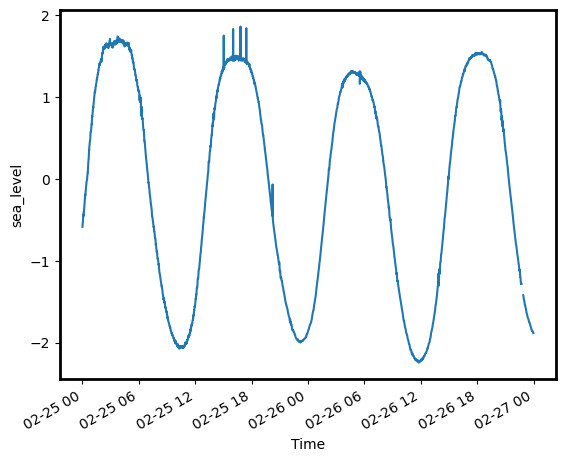

In [78]:
ds.sel(time=slice("2022-02-25","2022-02-26")).sea_level.plot()

In [79]:
#dsr = ds.sel(time=slice(cp.start - pd.Timedelta("10D"), cp.end + pd.Timedelta("10D"))).resample(time="10T").mean()
#dsr = ds.sel(time="2022").resample(time="10T").mean()
#dsr.sea_level.sel(time="2022-05").plot(figsize=(15,5))

### proceed with tidal analysis

In [80]:
df = ds.to_dataframe()
#df = dsr.to_dataframe()
df.ts.time_physical()
df.head()

,latitude,longitude,sea_level,timep
time,,,,
2022-01-01 00:00:32,49.279362,-0.24903,-1.369981,378691232.0
2022-01-01 00:01:32,49.279362,-0.24903,-1.391781,378691292.0
2022-01-01 00:02:32,49.279362,-0.24903,-1.413481,378691352.0
2022-01-01 00:03:32,49.279362,-0.24903,-1.440281,378691412.0
2022-01-01 00:04:32,49.279362,-0.24903,-1.459481,378691472.0


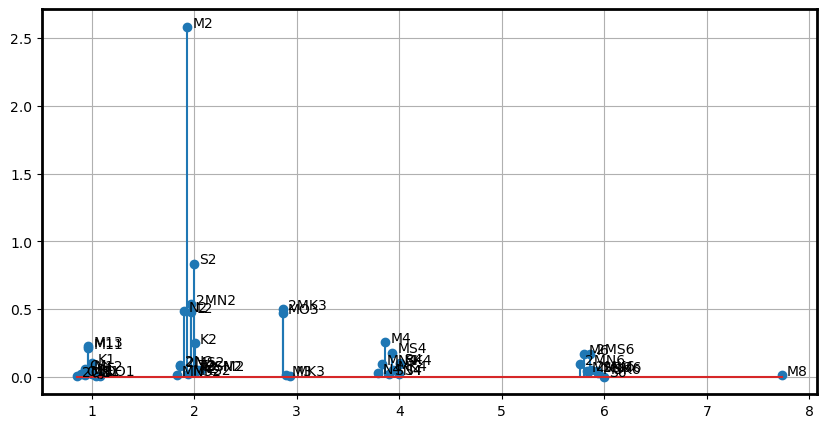

In [81]:
df.ts.tidal_analysis("sea_level", constituents=cst)

In [82]:
_df = df.ts._tidal_harmonics["sea_level"]
_df["abs_amplitude"] = np.abs(_df["amplitude"])
_df.sort_values("abs_amplitude", ascending=False)

,amplitude,frequency,frequency_rad,abs_amplitude
constituent,,,,
M2,0.480549-2.539237j,1.932274,0.000141,2.584308
S2,0.702722-0.451232j,2.000000,0.000145,0.835122
2MN2,-0.312098+0.433622j,1.968565,0.000143,0.534259
2MK3,-0.499718+0.034550j,2.861809,0.000208,0.500911
N2,-0.072067-0.478944j,1.895982,0.000138,0.484336
L2,0.225498-0.418374j,1.968565,0.000143,0.475275
MO3,0.470795-0.020729j,2.861809,0.000208,0.471252
M4,0.112629+0.232043j,3.864547,0.000281,0.257932
K2,0.199916-0.146426j,2.005476,0.000146,0.247804


In [83]:
new_time = pd.date_range(df.index[0].ceil("1T"), pd.Timestamp(2023,1,1), freq="1T")
dfr = df.reindex(pd.Index.union(df.index, new_time)).interpolate(limit_area="inside").reindex(new_time)
dfr.index.name = "time"

<AxesSubplot: xlabel='time'>

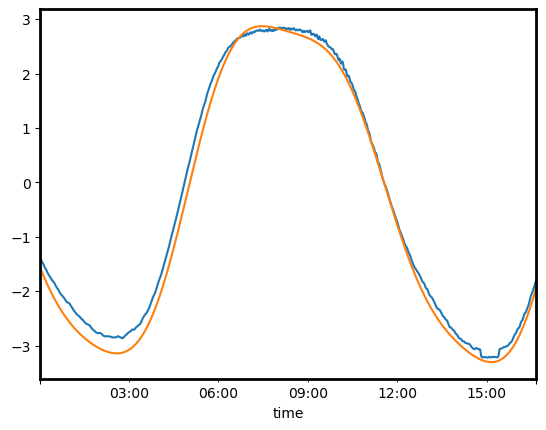

In [84]:
dfr["sea_level_tide"] = df.ts.tidal_predict("sea_level", time=dfr.index.values)

sl = slice(0,1000)
#sl = slice(0,None)

dfr["sea_level"].iloc[sl].plot()
dfr["sea_level_tide"].iloc[sl].plot()

<AxesSubplot: xlabel='time'>

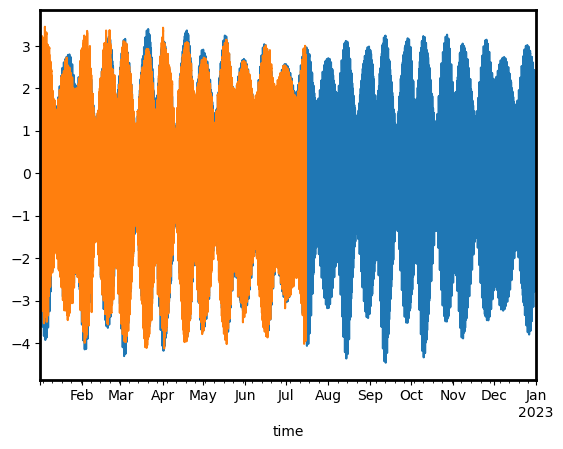

In [85]:
dfr["sea_level_tide"].plot()
dfr["sea_level"].plot()

In [86]:
df = dfr

### Inspect residual

Useful to identify 

Could do a spectral analysis

In [87]:
(df["sea_level"] - df["sea_level_tide"]).hvplot()

:Curve   [time]   (0)

### store

In [88]:
lon, lat = ds["longitude"].values[0], ds["latitude"].values[0]
ds = df.loc[:,["sea_level", "sea_level_tide"]].to_xarray()
ds.attrs.update(longitude=lon, latitude=lat)

In [89]:
#ds = ds.drop_vars(["longitude", "latitude"])

In [90]:
ds.to_netcdf(os.path.join(cp["path_processed"], f'{p}.nc'), mode="w")

In [92]:
ds = ds.resample(time="10T").mean()
ds.to_netcdf(os.path.join(cp["path_processed"], f'{p}_10min.nc'), mode="w")